# PDAN8412 ICE TASK 1

# ST10437305

# YAHYA MAHOMED 

## The Task

Create your first Image Recognition Classifier using CNN, Keras and Tensorflow backend. With the dawn of a new era of A.I., machine learning, and robotics, its time for the machines to perform tasks characteristic of human intelligence. Machines use their own senses to do things like…

## The List

- Find Nicholas Cage OR your fav celeb (use a dataset if fatkun freaks you out) with a CNN

- In S1, we used a KNN to find Nicholas's cage; now, we are going to use a CNN.  

- You will need to download some pictures of Nic: Here is a nice web scraper :https://chromewebstore.google.com/detail/fatkun-image-editor-fe/eebchbokmimedlkmnaknibgmdjkgmoff
 
- NNB LEARN SCRAPING IT IS USEFUL 

- Here is some help, but the CNN code in your textbook is also pretty good, I will also share the one we did to see if we had Lionel Messi or Idris Alba : https://medium.com/nybles/create-your-first-image-recognition-classifier-using-cnn-keras-and-tensorflow-backend-6eaab98d14dd
 
- Label your Nics, find a second person you like (  or hate ) scrape for images, create your dataset and train your model.
You will need to carefully clean your data as the images work best if they are facing sort of the same way
 

 

## The links I had used to complete this assignment

https://medium.com/edureka/tensorflow-image-classification-19b63b7bfd95

https://medium.com/nerd-for-tech/building-an-image-classifier-with-tensorflow-3e12c1d5d3a2

https://www.kaggle.com/code/tirendazacademy/image-classification-with-tensorflow

https://www.geeksforgeeks.org/image-recognition-using-tensorflow/

## Import the libraries

In [111]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models
from tensorflow.keras.models import Sequential
import matplotlib.pyplot as plt
import numpy as np
import os
import pathlib

## Import the image dataset

In [94]:
# Set the path to your folder containing images
data_dir = pathlib.Path('DATA/Nicolas_Cage_Photos')

## Adjust the parameters to your liking 

In [95]:
# Parameters - can be adjusted
img_height, img_width = 224, 224
batch_size = 100
epochs = 20

In [96]:
# Data preprocessing and augmentation
#datagen = ImageDataGenerator(
#    rescale=1./255,
 #   rotation_range=20,
  #  width_shift_range=0.2,
   # height_shift_range=0.2,
    #horizontal_flip=True,
    #validation_split=0.2
#)

## Training and Validation of the image dataset

In [97]:
# Load the dataset for training 
train_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset="training",
    seed=123,
    image_size=(img_height, img_width),
    batch_size=batch_size
)


Found 95 files belonging to 2 classes.
Using 76 files for training.
Found 95 files belonging to 2 classes.
Using 19 files for validation.


In [ ]:
# Load the dataset for validation
validation_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset="validation",
    seed=123,
    image_size=(img_height, img_width),
    batch_size=batch_size
)

## Creating the image classifier model

In [98]:
# Load pre-trained MobileNetV2 model
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
base_model.trainable = False

In [99]:
# Define the model
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1, activation='sigmoid')
])

In [100]:
# Calculate steps per epoch and validation steps
train_steps = tf.data.experimental.cardinality(train_dataset).numpy()
validation_steps = tf.data.experimental.cardinality(validation_dataset).numpy()

In [101]:
# Compile the model
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=['accuracy']
)

In [102]:
# If the datasets are infinite (repeat is used), set a fixed number of steps
if train_steps == tf.data.INFINITE_CARDINALITY:
    train_steps = 1000  # or any other number that makes sense for your dataset
if validation_steps == tf.data.INFINITE_CARDINALITY:
    validation_steps = 200  # or any other number that makes sense for your dataset


## Training the model

In [103]:
# Train the model
history = model.fit(
    train_dataset,
    epochs=epochs,
    steps_per_epoch=train_steps,
    validation_data=validation_dataset,
    validation_steps=validation_steps
)

Epoch 1/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 12s 12s/step - accuracy: 0.4605 - loss: 1.0132 - val_accuracy: 0.3684 - val_loss: 0.9251
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.4211 - loss: 0.9588 - val_accuracy: 0.3684 - val_loss: 0.9234
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.4474 - loss: 0.8940 - val_accuracy: 0.3158 - val_loss: 0.9270
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.5395 - loss: 0.8651 - val_accuracy: 0.3158 - val_loss: 0.9294
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00
Epoch 9/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.6184 - loss: 0.7679 - val_accuracy: 0.3158 - val_loss: 0.9253
Epoch 10/20
1/1 ━━

## Display the photo labels

In [104]:
# Function to display sample images from the training set
def display_sample_images(train_dataset):
    #class_names = train_dataset.class_names
    class_names = ['Nicolas Cage', 'Not Cage']
    plt.figure(figsize=(10, 10))
    for images, labels in train_dataset.take(1):
        for i in range(9):
            ax = plt.subplot(3, 3, i + 1)
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(class_names[labels[i]])
            plt.axis("off")
    plt.show()

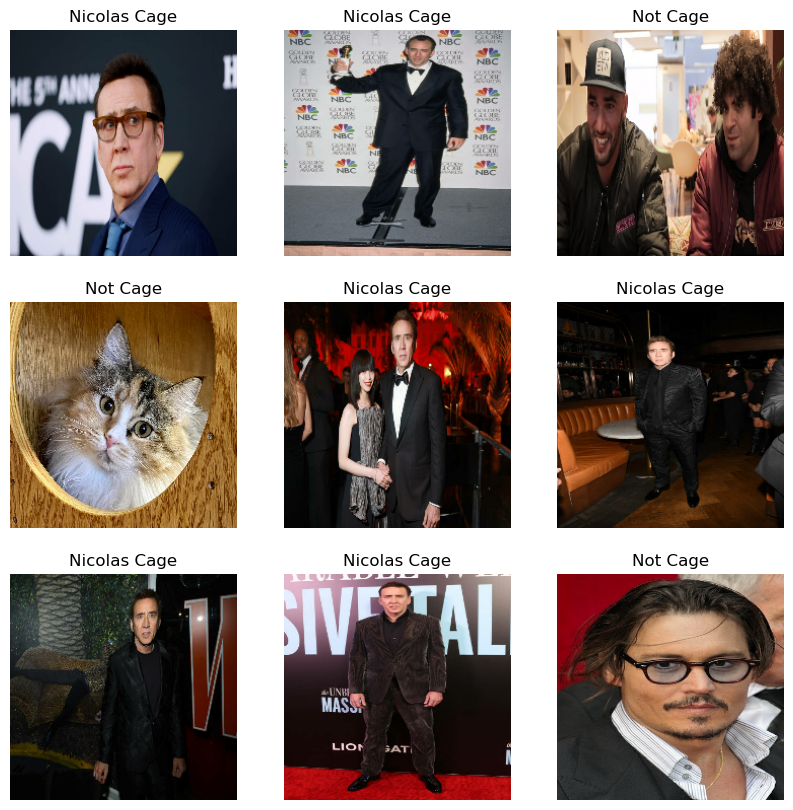

In [105]:
display_sample_images(train_dataset)

## Model data summary

In [106]:
model.summary()

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_5      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,750,277 (10.49 MB)

 Trainable params: 164,097 (641.00 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

 Optimizer params: 328,196 (1.25 MB)

## Visualization for model accuracy

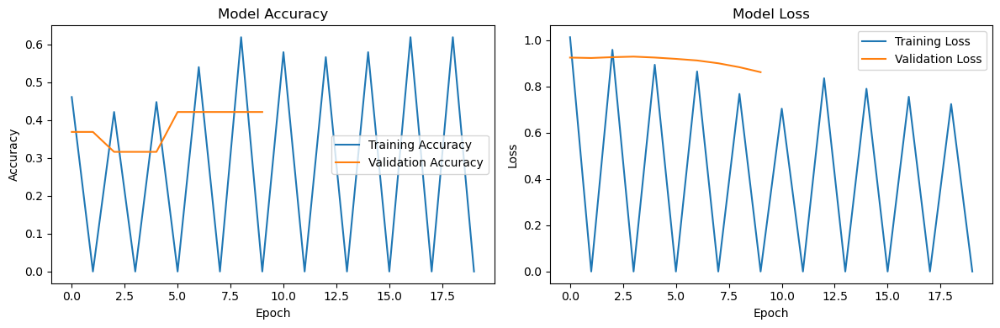

In [107]:
# Plot training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

## Final Results of the model

In [108]:
# Function to scan a folder and predict all images
def predict_folder(model, folder_path):
    valid_extensions = {'.jpg', '.jpeg', '.png', '.gif'}
    images = [f for f in os.listdir(folder_path) if os.path.splitext(f)[1].lower() in valid_extensions]
    
    num_images = len(images)
    cols = 4
    rows = (num_images + cols - 1) // cols
    
    fig = plt.figure(figsize=(15, 5 * rows))
    
    for i, image_name in enumerate(images):
        img_path = os.path.join(folder_path, image_name)
        
        # Load and preprocess the image
        img = tf.keras.preprocessing.image.load_img(
            img_path, target_size=(img_height, img_width)
        )
        img_array = tf.keras.preprocessing.image.img_to_array(img)
        img_array = tf.expand_dims(img_array, 0)  # Create batch axis
        img_array /= 255.0  # Rescale the image

        # Make prediction
        prediction = model.predict(img_array)
        score = prediction[0][0]

        class_names = ['Nicolas Cage', 'Not Cage']
        predicted_class = class_names[int(round(score))]
        confidence = (1 - score) * 100 if score < 0.5 else score * 100
        
        # Display the image and prediction
        ax = fig.add_subplot(rows, cols, i+1)
        ax.imshow(img)
        ax.set_title(f"{predicted_class}\n{confidence:.2f}%")
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()

    print(f"Processed {num_images} images from {folder_path}")

In [109]:
test_folder = 'DATA/Test'

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━

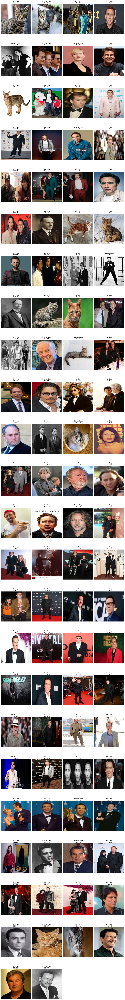

Processed 94 images from DATA/Test


In [110]:
predict_folder(model, test_folder)

Sadly this model will need alot more adjustments considering it is unable to correctly use the labels. It may depend on the number of images to train on or an error with the actual labelling. 